# Backpack price prediction challenge from kaggle

### Predict the price of backpack

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [2]:
df = pd.read_csv("train.csv")
pd.set_option("display.max_columns",None)
df.head()

,id,Brand,Material,Size,Compartments,Laptop Compartment,Waterproof,Style,Color,Weight Capacity (kg),Price
0,0,Jansport,Leather,Medium,7.0,Yes,No,Tote,Black,11.611723,112.15875
1,1,Jansport,Canvas,Small,10.0,Yes,Yes,Messenger,Green,27.078537,68.88056
2,2,Under Armour,Leather,Small,2.0,Yes,No,Messenger,Red,16.643760,39.17320
3,3,Nike,Nylon,Small,8.0,Yes,No,Messenger,Green,12.937220,80.60793
4,4,Adidas,Canvas,Medium,1.0,Yes,Yes,Messenger,Green,17.749338,86.02312


In [3]:
print(f"Number of rows: {df.shape[0]}")
print(f"Number of columns : {df.shape[1]}")

Number of rows: 300000
Number of columns : 11


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300000 entries, 0 to 299999
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    300000 non-null  int64  
 1   Brand                 290295 non-null  object 
 2   Material              291653 non-null  object 
 3   Size                  293405 non-null  object 
 4   Compartments          300000 non-null  float64
 5   Laptop Compartment    292556 non-null  object 
 6   Waterproof            292950 non-null  object 
 7   Style                 292030 non-null  object 
 8   Color                 290050 non-null  object 
 9   Weight Capacity (kg)  299862 non-null  float64
 10  Price                 300000 non-null  float64
dtypes: float64(3), int64(1), object(7)
memory usage: 25.2+ MB


# Data Preprocessing



In [5]:
df.isnull().sum()

id                         0
Brand                   9705
Material                8347
Size                    6595
Compartments               0
Laptop Compartment      7444
Waterproof              7050
Style                   7970
Color                   9950
Weight Capacity (kg)     138
Price                      0
dtype: int64

#### Handling missing values of brand

In [6]:
df['Brand'].value_counts()

Brand
Adidas          60077
Under Armour    59992
Nike            57336
Puma            56814
Jansport        56076
Name: count, dtype: int64

In [7]:
print("Checking whether brand is related with price")
df.groupby("Brand")["Price"].mean()

Checking whether brand is related with price


Brand
Adidas          80.631060
Jansport        81.791276
Nike            81.319209
Puma            81.448607
Under Armour    81.976311
Name: Price, dtype: float64

In [8]:
print("Checking whether brand is related with material")
pd.crosstab(df['Material'], df['Brand'])

Checking whether brand is related with material


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Material,,,,,
Canvas,13755,12565,13205,12648,13645
Leather,14706,13843,14299,13654,14558
Nylon,13860,13463,13226,13553,14239
Polyester,16103,14661,15035,15395,15883


In [9]:
print("Checking whether brand is related with Color")
pd.crosstab(df['Color'],df['Brand'])

Checking whether brand is related with Color


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Color,,,,,
Black,9368,8629,8833,8691,9339
Blue,9531,9104,9215,9041,9643
Gray,9875,9362,9673,9628,10174
Green,9317,8636,8924,8801,9245
Pink,10431,9760,9796,9805,10228
Red,9596,8771,9055,8872,9385


In [10]:
print("Checking whether brand is related with compartments")
df.groupby("Brand")["Compartments"].mean()

Checking whether brand is related with compartments


Brand
Adidas          5.452336
Jansport        5.438405
Nike            5.459955
Puma            5.433309
Under Armour    5.426290
Name: Compartments, dtype: float64

In [11]:
print("Cheking whether brand is related with laptop compartment")
pd.crosstab(df['Brand'],df['Laptop Compartment'])

Cheking whether brand is related with laptop compartment


Laptop Compartment,No,Yes
Brand,,
Adidas,29073,29505
Jansport,26939,27799
Nike,27478,28541
Puma,27414,27939
Under Armour,28626,29786


In [12]:
print("Checking whether brand is related with weight Capacity (kg)")
df.groupby("Brand")["Weight Capacity (kg)"].mean()

Checking whether brand is related with weight Capacity (kg)


Brand
Adidas          18.079028
Jansport        18.004941
Nike            18.024887
Puma            17.956418
Under Armour    18.110693
Name: Weight Capacity (kg), dtype: float64

In [13]:
print("Checking whether brand is related with water proof")
pd.crosstab(df['Brand'],df['Waterproof'])

Checking whether brand is related with water proof


Waterproof,No,Yes
Brand,,
Adidas,29080,29590
Jansport,27188,27524
Nike,27453,28523
Puma,27495,27939
Under Armour,28878,29688


In [14]:
print("Checking whether brand is related with color")
pd.crosstab(df['Brand'],df['Color'])

Checking whether brand is related with color


Color,Black,Blue,Gray,Green,Pink,Red
Brand,,,,,,
Adidas,9368,9531,9875,9317,10431,9596
Jansport,8629,9104,9362,8636,9760,8771
Nike,8833,9215,9673,8924,9796,9055
Puma,8691,9041,9628,8801,9805,8872
Under Armour,9339,9643,10174,9245,10228,9385


Since no other feature is related with the brand we proportional imputation - to avoid disproportion of brand

In [15]:
brand_distribution = df['Brand'].value_counts(normalize=True)
brand_distribution

Brand
Adidas          0.206952
Under Armour    0.206659
Nike            0.197509
Puma            0.195711
Jansport        0.193169
Name: proportion, dtype: float64

In [16]:
missing_brand_indices = df[df['Brand'].isnull()].index
df.loc[missing_brand_indices,"Brand"] = np.random.choice(brand_distribution.index,size=len(missing_brand_indices),p=brand_distribution.values)

In [17]:
df['Brand'].value_counts(normalize=True) # this shows we almost normalized the bias 

Brand
Adidas          0.207100
Under Armour    0.206510
Nike            0.197533
Puma            0.195677
Jansport        0.193180
Name: proportion, dtype: float64

#### Handling missing values of feature - material

We do proportional imputation 


In [18]:
material_distribution = df['Material'].value_counts(normalize=True)
material_distribution

Material
Polyester    0.273030
Leather      0.251724
Nylon        0.242079
Canvas       0.233167
Name: proportion, dtype: float64

In [19]:
missing_material_indices = df[df['Material'].isnull()].index
df.loc[missing_material_indices,'Material'] = np.random.choice(material_distribution.index,size=len(missing_material_indices),p=material_distribution.values)

#### Handling missing values of size
We do proportion imputation

In [20]:
missing_size = df['Size'].value_counts(normalize=True)
missing_size_indices  = df[df['Size'].isnull()].index
df.loc[missing_size_indices,'Size'] = np.random.choice(missing_size.index,size = len(missing_size_indices),p = missing_size.values)


In [21]:
df.isnull().sum()

id                         0
Brand                      0
Material                   0
Size                       0
Compartments               0
Laptop Compartment      7444
Waterproof              7050
Style                   7970
Color                   9950
Weight Capacity (kg)     138
Price                      0
dtype: int64

#### Handling missing values of Laptop compartments

In [22]:
missing_laptop_compartment = df['Laptop Compartment'].value_counts(normalize=True)
missing_laptop_compartment_indices  = df[df['Laptop Compartment'].isnull()].index
df.loc[missing_laptop_compartment_indices,'Laptop Compartment'] = np.random.choice(missing_laptop_compartment.index,
                                                                                   size = len(missing_laptop_compartment_indices),
                                                                                   p = missing_laptop_compartment.values)

#### Handling missing values of Waterproof

In [23]:
missing_waterproof = df['Waterproof'].value_counts(normalize=True)
missing_waterproof_indices  = df[df['Waterproof'].isnull()].index
df.loc[missing_waterproof_indices,'Waterproof'] = np.random.choice(missing_waterproof.index,
                                                                                   size = len(missing_waterproof_indices),
                                                                                   p = missing_waterproof.values)

#### Handling missing values of Style

In [24]:
df["Style"].fillna(df["Style"].mode()[0], inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\1596473975.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["Style"].fillna(df["Style"].mode()[0], inplace=True)


#### Handling missing values of Color

In [25]:
df['Color'].fillna(df['Color'].mode()[0],inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\1859550221.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Color'].fillna(df['Color'].mode()[0],inplace=True)


#### Handling missing values of weight capacity

In [26]:
df.fillna({'Weight Capacity (kg)':df['Weight Capacity (kg)'].mean()},inplace=True)

In [27]:
df.isnull().sum()

id                      0
Brand                   0
Material                0
Size                    0
Compartments            0
Laptop Compartment      0
Waterproof              0
Style                   0
Color                   0
Weight Capacity (kg)    0
Price                   0
dtype: int64

Checking for outliers

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


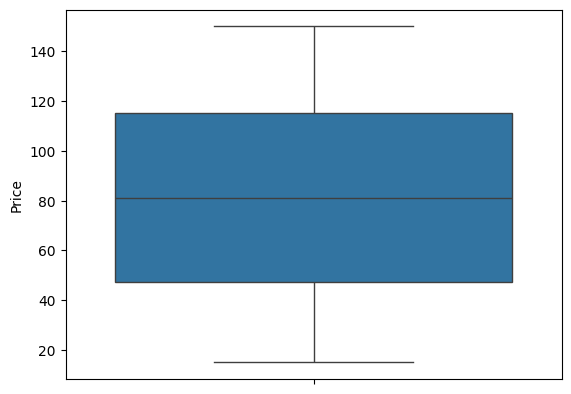

In [28]:
sns.boxplot(df['Price'])
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


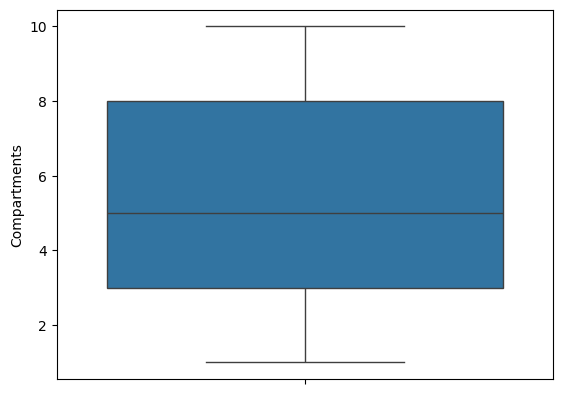

In [29]:
sns.boxplot(df['Compartments'])
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


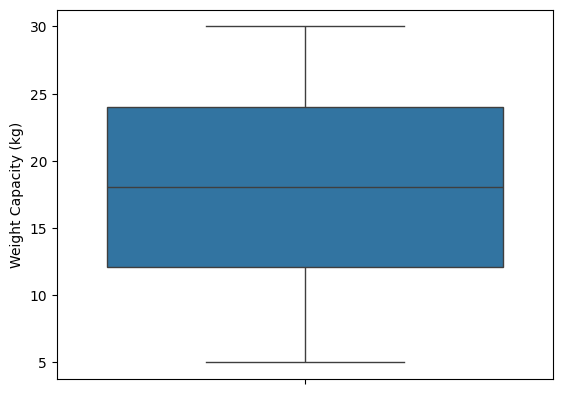

In [30]:
sns.boxplot(df['Weight Capacity (kg)'])
plt.show()

## Exploratory Data Analysis

### Univariate Analysis

#### 1. Categorical

In [31]:
numeric = df.select_dtypes(include='number').columns.tolist()[1:]
categorical = df.select_dtypes(include='object').columns.tolist()
print("Numerical columns : ",numeric)
print("categorical columns :",categorical)

Numerical columns :  ['Compartments', 'Weight Capacity (kg)', 'Price']
categorical columns : ['Brand', 'Material', 'Size', 'Laptop Compartment', 'Waterproof', 'Style', 'Color']


In [33]:
def univ_cat(df, col):
    fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'pie'}]], subplot_titles=['Histogram', 'Pie'])
    fig.add_trace(go.Histogram(x=df[col]), 1, 1)
    fig.add_trace(go.Pie(labels=df[col].value_counts().index, values=df[col].value_counts(), textinfo='label+percent'), 1, 2)
    fig.update_layout( title_text=f'{col}')
    fig.update_traces(showlegend=False)
    fig.show()

In [34]:
for column in categorical:
    univ_cat(df,column)

#### 2. Numerical 

In [35]:
print(df[numeric].describe())

        Compartments  Weight Capacity (kg)          Price
count  300000.000000         300000.000000  300000.000000
mean        5.443590             18.029994      81.411107
std         2.890766              6.965312      39.039340
min         1.000000              5.000000      15.000000
25%         3.000000             12.099086      47.384620
50%         5.000000             18.064618      80.956120
75%         8.000000             24.001145     115.018160
max        10.000000             30.000000     150.000000


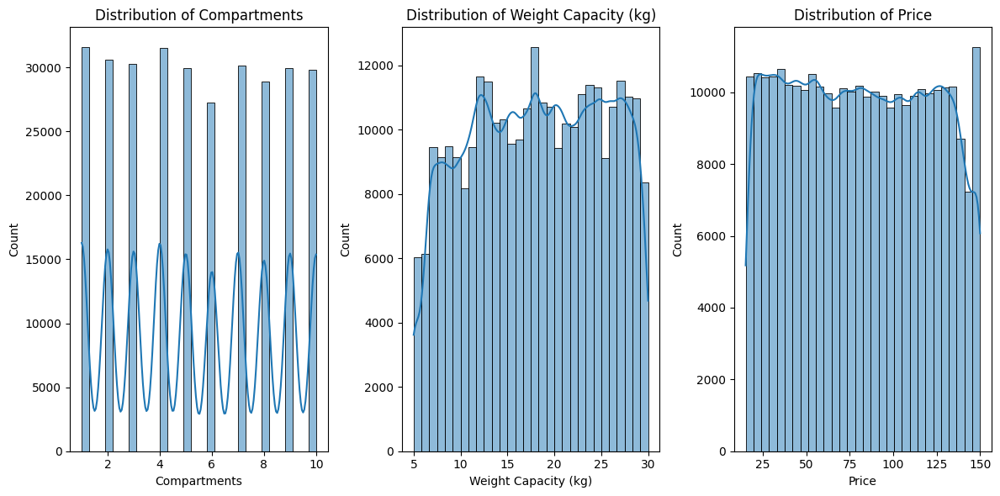

In [36]:
plt.figure(figsize=(12, 6))
for i, col in enumerate(numeric, 1):
    plt.subplot(1, 3, i)
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f"Distribution of {col}")
plt.tight_layout()
plt.show()


This shows 
1. compartments are discrete
2. Weight Capacity and Price are Uniformly distributed 

### Bivariate Analysis

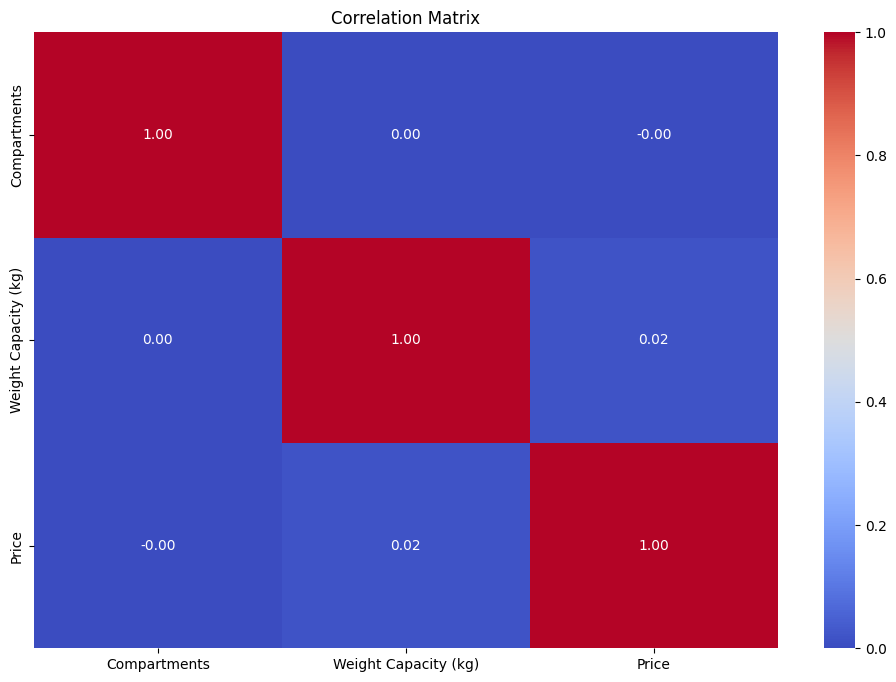

In [37]:
correlation_matrix = df[numeric].corr()
plt.figure(figsize=(12,8))

sns.heatmap(correlation_matrix,annot = True, fmt = '.2f',cmap = 'coolwarm')
plt.title("Correlation Matrix")
plt.show()

This shows weak or no relationship as all correlation values is  < 0.2 

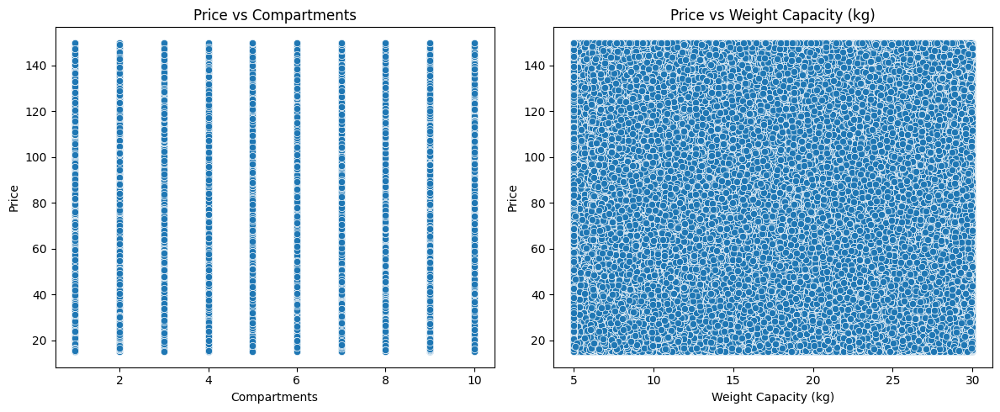

In [38]:
plt.figure(figsize=(12, 5))
for i, col in enumerate(numeric[:-1], 1):
    plt.subplot(1, 2, i)
    sns.scatterplot(x=df[col], y=df["Price"])
    plt.title(f"Price vs {col}")
plt.tight_layout()
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



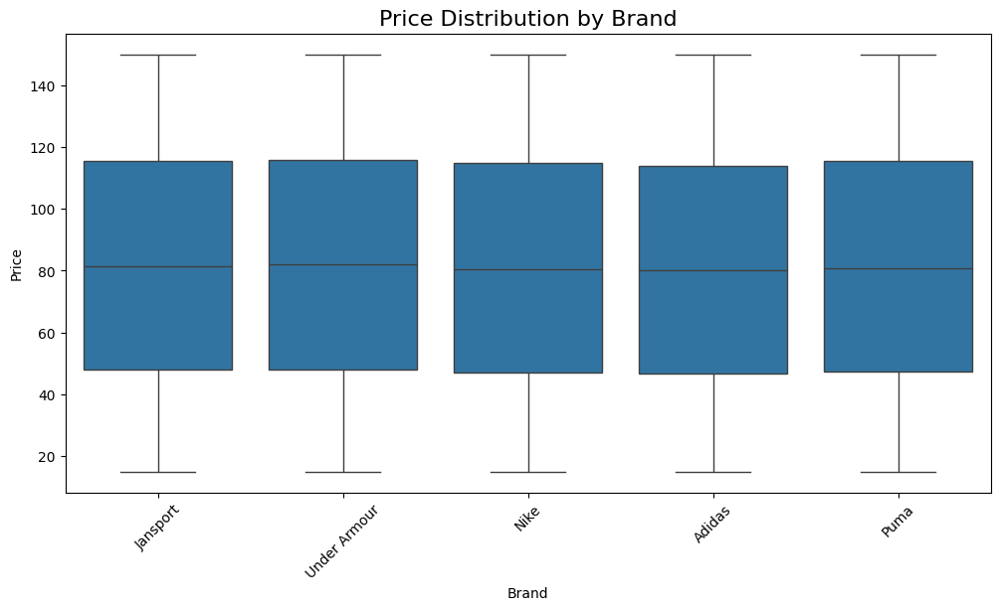

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



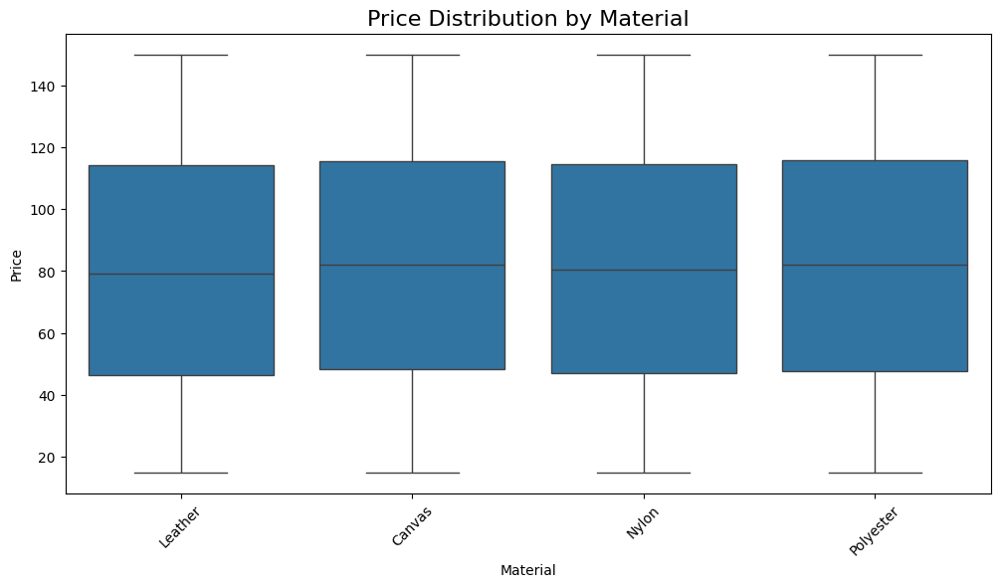

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



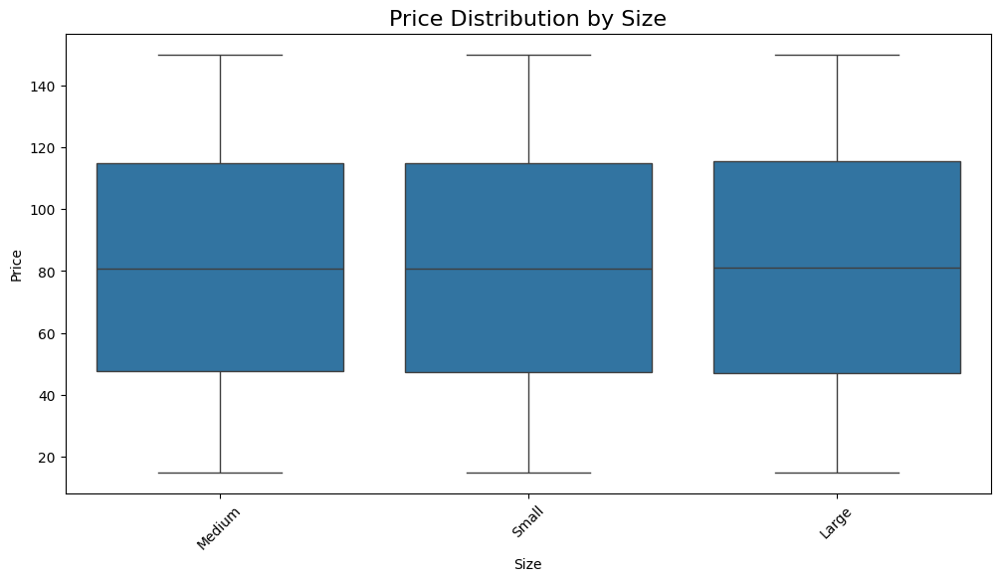

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



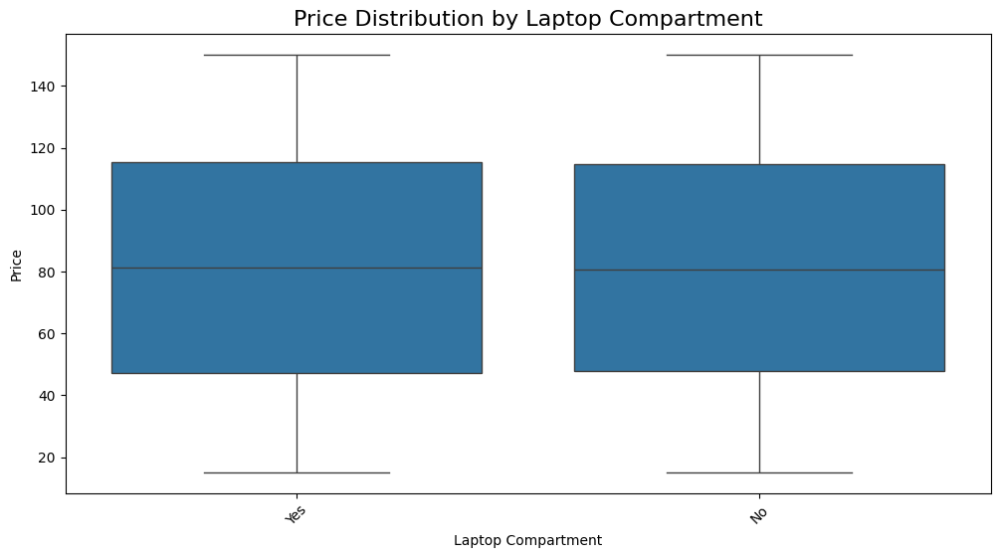

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



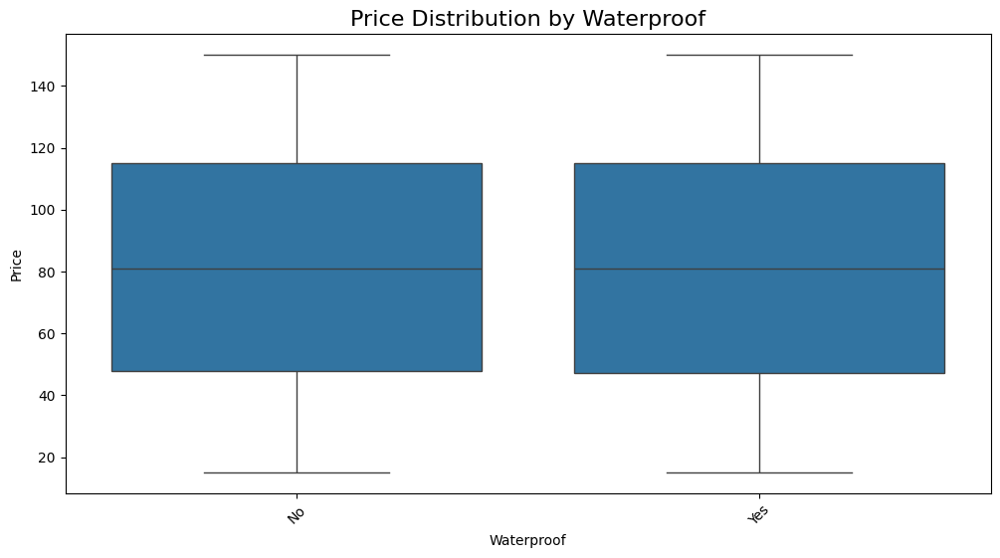

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



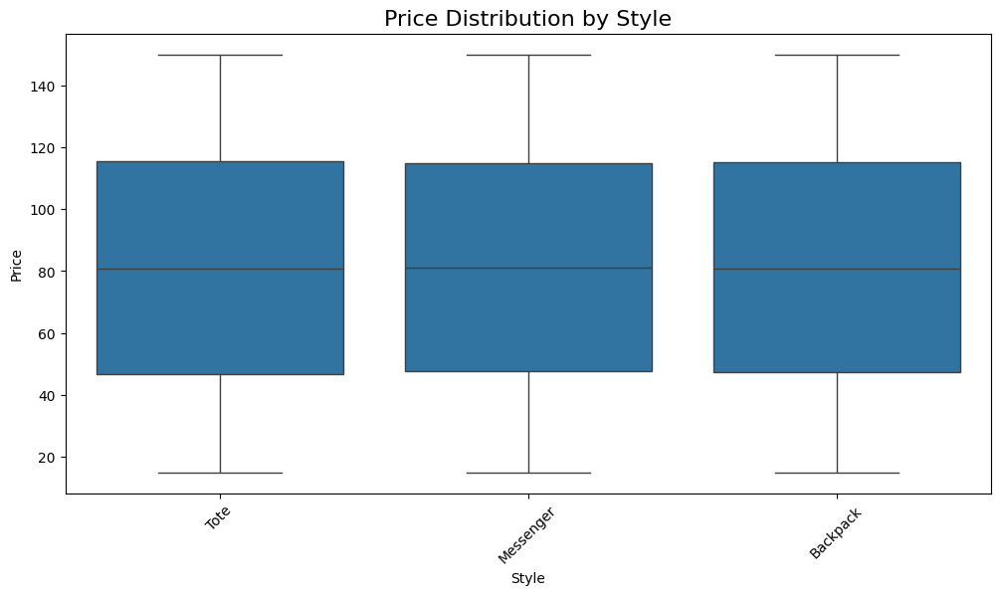

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



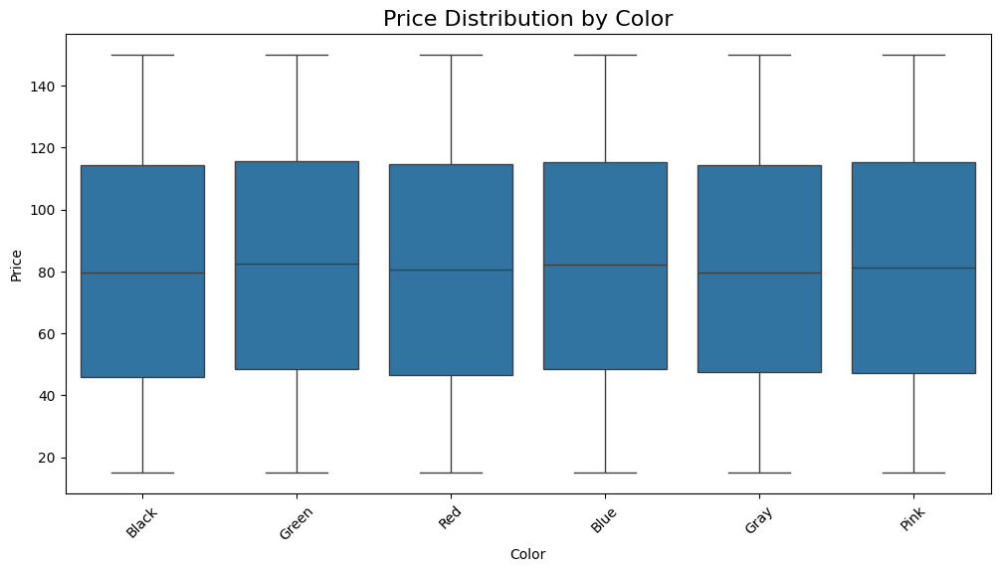

In [39]:
for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=df, x=col, y='Price', hue=None)  
    plt.title(f'Price Distribution by {col}', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


In [40]:

for col in categorical:
    group_stats = df.groupby(col)['Price'].agg(['mean', 'median', 'std']).sort_values(by='mean', ascending=False)
    print(f"\nStatistics for {col}:\n", group_stats)



Statistics for Brand:
                    mean     median        std
Brand                                        
Under Armour  81.942430  81.940850  38.972557
Jansport      81.768559  81.474215  38.992080
Puma          81.442213  80.662570  39.255092
Nike          81.299536  80.607930  39.128699
Adidas        80.624897  80.047180  38.847766

Statistics for Material:
                 mean     median        std
Material                                  
Canvas     82.062265  82.055720  39.021413
Polyester  82.016707  81.940850  39.098859
Nylon      81.065639  80.371045  38.897292
Leather    80.484190  79.230685  39.105875

Statistics for Size:
              mean     median        std
Size                                   
Large   81.571830  81.157170  39.354215
Small   81.369376  80.805805  39.026650
Medium  81.293645  80.881900  38.743813

Statistics for Laptop Compartment:
                          mean     median        std
Laptop Compartment                                 
No   


Statistics for Style:
                 mean    median        std
Style                                    
Messenger  81.451328  81.20564  38.886298
Backpack   81.402513  80.84331  39.039632
Tote       81.374865  80.75943  39.208353

Statistics for Color:
             mean    median        std
Color                                
Green  82.381308  82.49228  38.934312
Blue   82.006994  82.30756  38.833774
Pink   81.653538  81.13414  39.141575
Red    81.011644  80.72338  39.391864
Gray   80.851971  79.78348  38.682311
Black  80.513439  79.51800  39.212778


#### Inferences from statistics:
1. Under Armour brand has highest mean - 81.922844.There is price consistency among the brands
2. Canvas and polyester has high mean prices. Leather’s lower mean and high standard deviation could indicate a wider variety in quality and pricing tiers. 
3. The mean price is proportional to size 
4. Laptop compartment might be standard in most bags since there isn't much mean price difference. 
5. Bags without waterproof might have styles and designs
6. Messenger styled bags have higher mean.
7. Green,Blue bags have high mean prices - could be professional
8. Red has high std deviation so it might have high vareity and designs with wider price range 
9. Gray and Black has lower mean. 

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




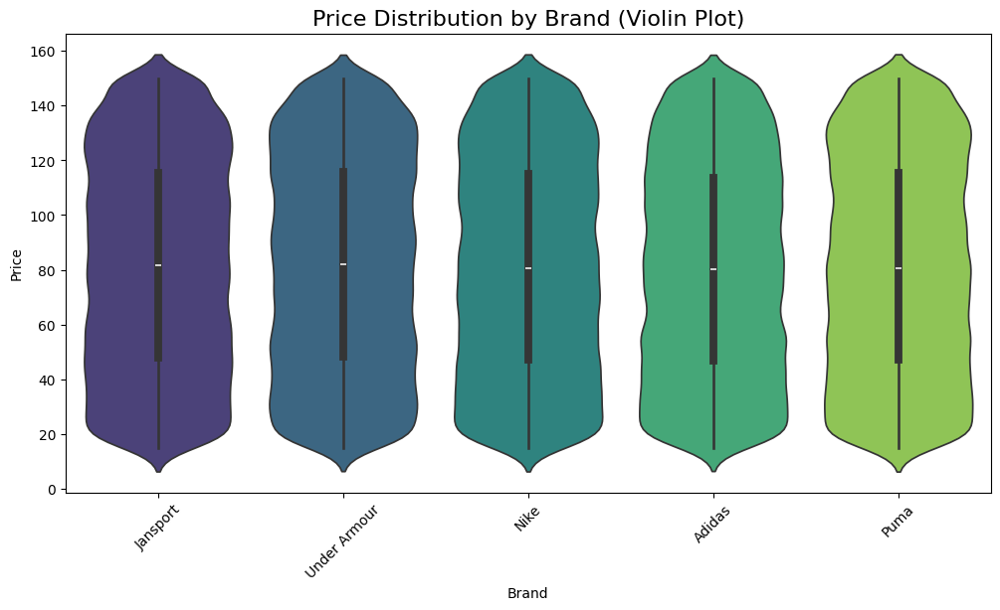

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




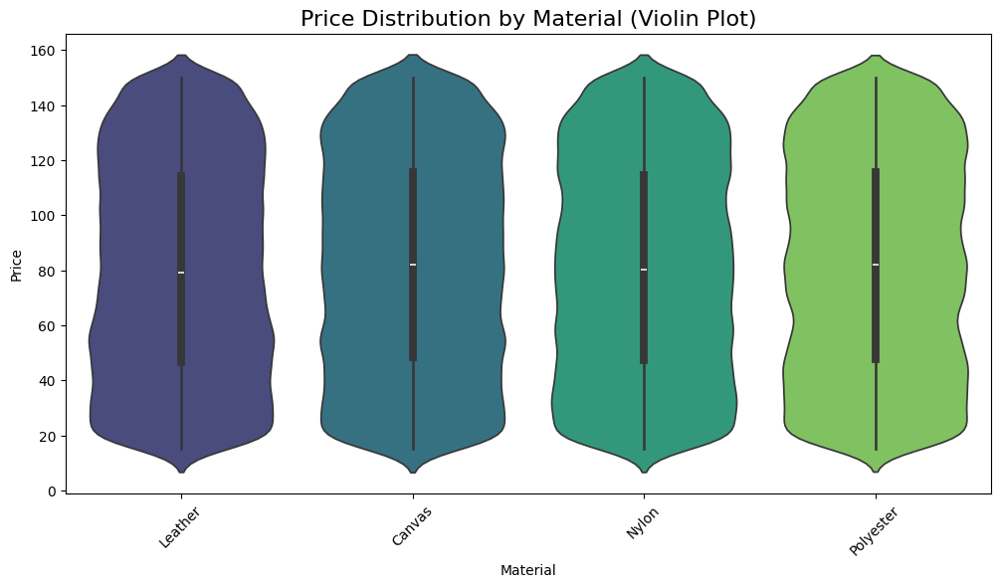

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




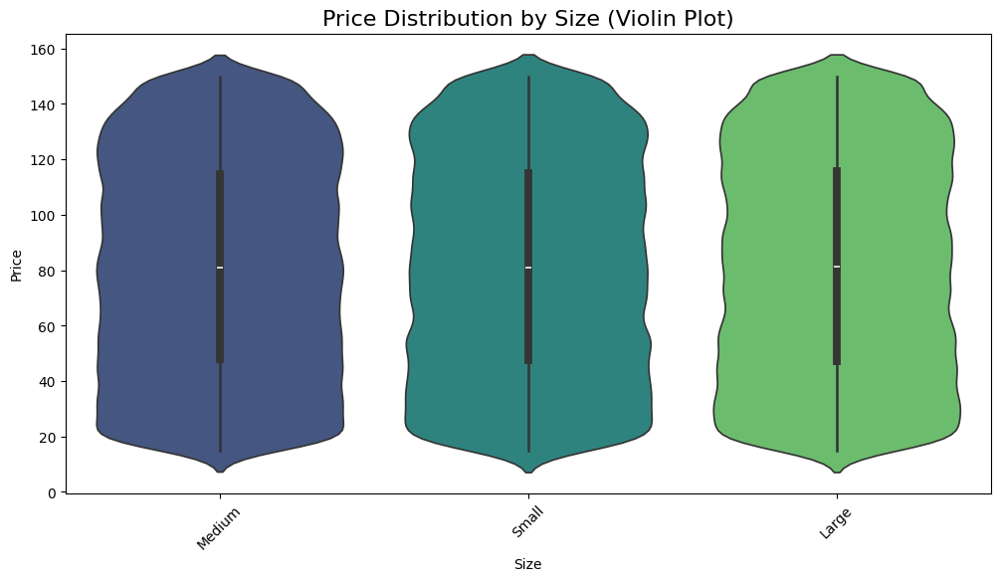

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




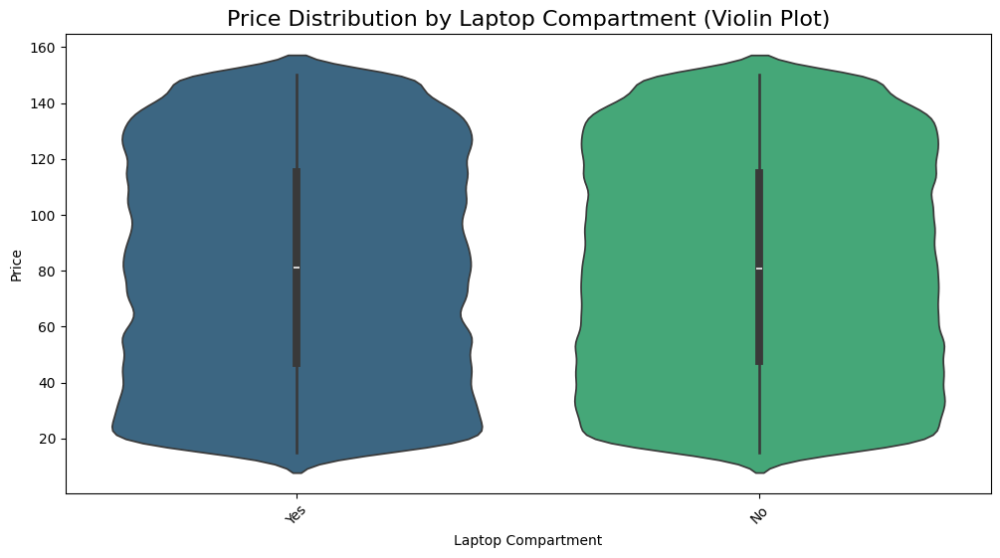

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




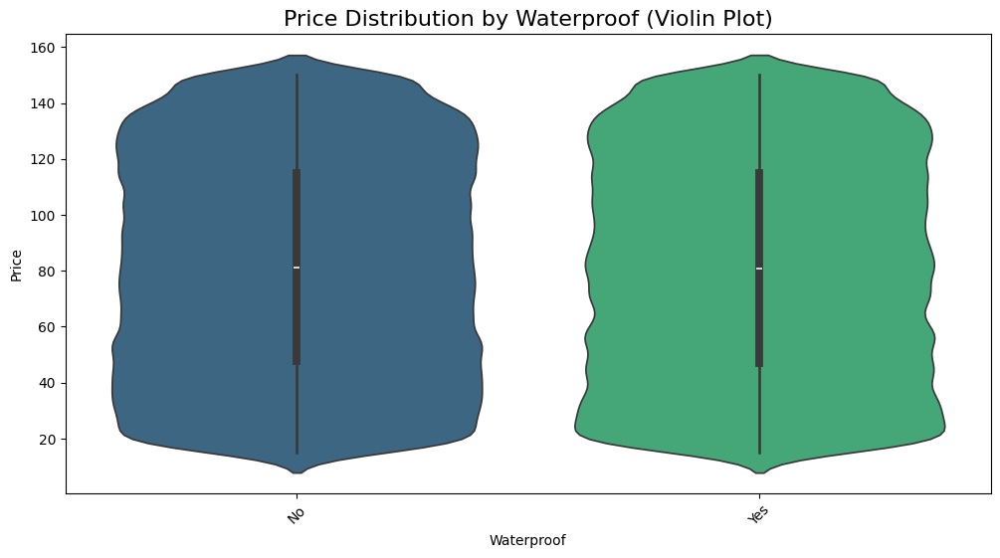

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




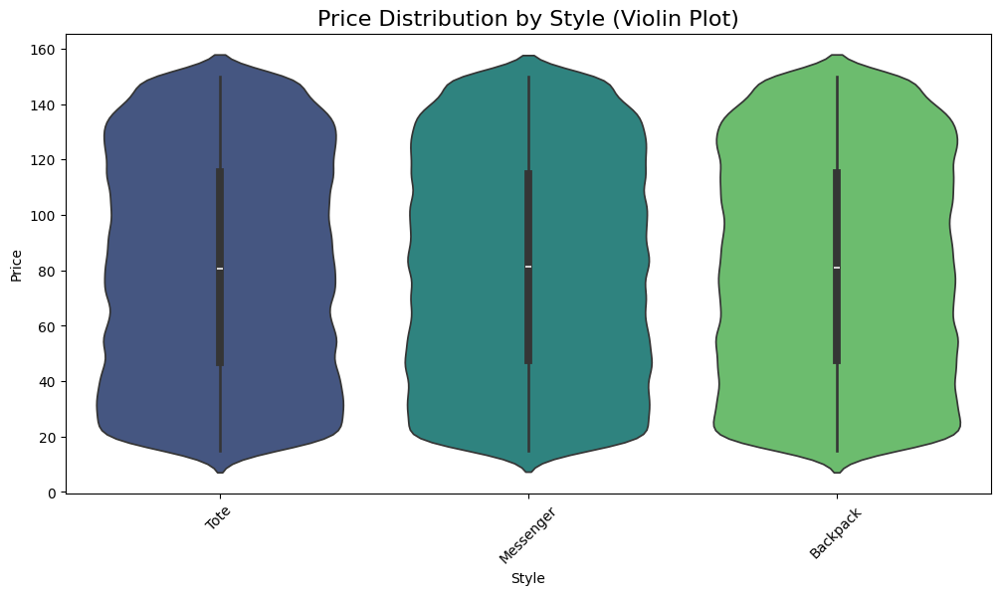

C:\Users\USER\AppData\Local\Temp\ipykernel_9900\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




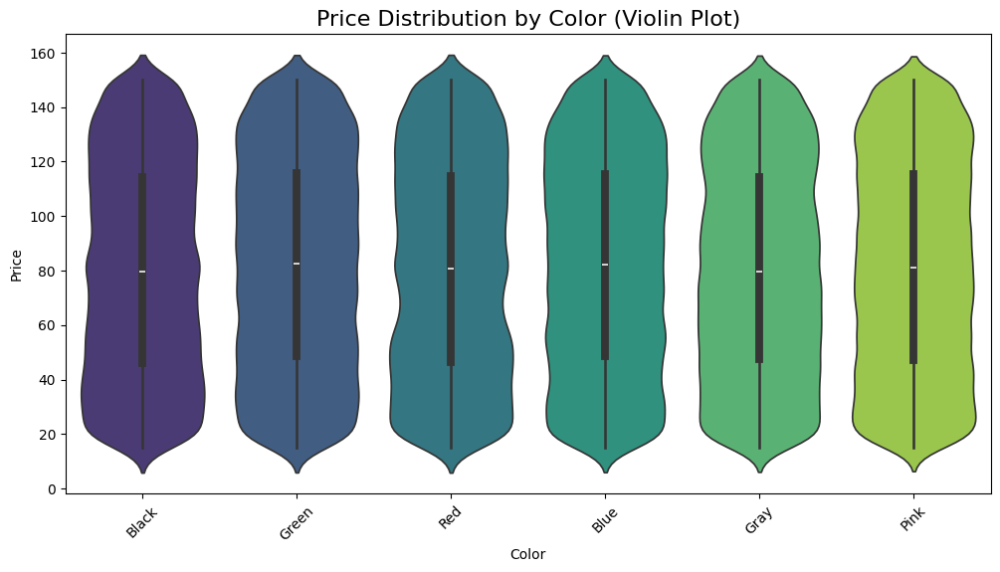

In [41]:

for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.violinplot(data=df, x=col, y='Price', palette='viridis',hue = None)
    plt.title(f'Price Distribution by {col} (Violin Plot)', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


## Feature Engineering

In [42]:
df['Price_to_compartment'] = df['Price']/df['Compartments']

In [43]:
df['weight_to_compartment'] = df['Weight Capacity (kg)'] / df['Compartments']

In [44]:
df['Price'].describe()

count    300000.000000
mean         81.411107
std          39.039340
min          15.000000
25%          47.384620
50%          80.956120
75%         115.018160
max         150.000000
Name: Price, dtype: float64

Using quantile binning for Price

In [45]:
df['Price_bin'] = pd.qcut(df['Price'], q=5, labels=False)
df['Price_bin'].value_counts().sort_index()

Price_bin
0    60003
1    59998
2    60001
3    60005
4    59993
Name: count, dtype: int64

In [46]:
print(df['Weight Capacity (kg)'].describe())

count    300000.000000
mean         18.029994
std           6.965312
min           5.000000
25%          12.099086
50%          18.064618
75%          24.001145
max          30.000000
Name: Weight Capacity (kg), dtype: float64


Using quantile binning for Weight capacity

In [47]:
df['weight_bin'] = pd.qcut(df['Weight Capacity (kg)'], q=5, labels=False)
print(df['weight_bin'].value_counts().sort_index()) 

weight_bin
0    60000
1    60000
2    60000
3    60000
4    60000
Name: count, dtype: int64


In [48]:

weight_price_stats = df.groupby('weight_bin')['Price'].agg(['mean', 'median', 'std', 'count'])
print(weight_price_stats)


                 mean     median        std  count
weight_bin                                        
0           79.691273  78.286690  38.804411  60000
1           81.402033  80.239520  39.472656  60000
2           82.407696  82.842560  39.006042  60000
3           81.701418  81.971070  39.009820  60000
4           81.853114  81.527325  38.847278  60000


In [49]:
df['Price_per_kg'] = df['Price'] / df['Weight Capacity (kg)']

In [50]:
df = pd.get_dummies(df, columns=['Brand', 'Material', 'Style', 'Color','Waterproof','Laptop Compartment'], drop_first=True)

In [51]:
size_mapping = {'Small': 0, 'Medium': 1, 'Large': 2}
df['Size'] = df['Size'].map(size_mapping)


In [52]:
scaler = StandardScaler()  # or MinMaxScaler()
df[['Price', 'Weight Capacity (kg)', 'Compartments','Price_to_compartment','weight_to_compartment','Price_per_kg']] = scaler.fit_transform(
    df[['Price', 'Weight Capacity (kg)', 'Compartments','Price_to_compartment','weight_to_compartment','Price_per_kg']])

In [53]:
df.to_csv("cleaned_test.csv", index=False)

In [54]:
df_copy = df.drop(columns=['id'])

Splitting the dataset

In [66]:
X = df_copy.drop(columns=['Price'])
y = df_copy['Price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Model Training -  Linear Regression

In [67]:
model_LinearRegression = LinearRegression()
model_LinearRegression.fit(X_train,y_train)

LinearRegression()

In [68]:
y_pred = model_LinearRegression.predict(X_test)

In [69]:
len(y_pred)

60000

In [71]:
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("R² Score:", r2_score(y_test, y_pred))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)

MAE: 0.16183799728972215
MSE: 0.036579468458910545
R² Score: 0.9632408664760419
RMSE: 0.1912575971273051
